# OpenCV - Final Project

<table style="margin-left: 0px; margin-top: 20px; margin-bottom: 20px;">
<tr>
<td style="width:120px; padding-top: 10px; padding-bottom: 10px;"><img src="assets/logo_ipparis.png" style="height: 130px;"></td>
<td style="padding-left: 12px;">
<table style="width: 100%;">
<tr>
<th style="text-align: left; width: 80px;">File</th>
<td style="text-align: left;">Final_Project_Sara_Naranjo.ipynb</td>
</tr>
<tr>
<th style="text-align: left;">Author</th>
<td style="text-align: left;">Sara NARANJO</td>
</tr>
<tr>
<th style="text-align: left;">Affiliation</th>
<td style="text-align: left;">Institut Polytechnique de Paris &nbsp;|&nbsp; Telecom SudParis &nbsp;</td>
</tr>
<tr>
<th style="text-align: left;">Date</th>
<td style="text-align: left;">Octobre 25, 2024</td>
</tr>
<tr>
<th style="text-align: left;">Description</th>
<td style="text-align: left;">Real-Time Keypoint Detection and Image Alignment in Video Streams using OpenCV</td>
</tr>
</table>
</td>
</tr>
</table>

<span style="font-size: 14pt; font-weight: bold;">1.&nbsp; Loading the Image and Test Video Capture</span>

<span style="font-size: 12pt; font-weight: bold;">a.&nbsp; Load the Marker Image</span>
<p>We start importing the necessary libraries like <tt><span style="color:#0000ff;">cv2</span></tt>, <tt><span style="color:#0000ff;">numpy</span></tt> and  <tt><span style="color:#0000ff;">matplotlib</span></tt>.</p>

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import time
import pandas as pd
from IPython.display import display, clear_output

We can now <b>load</b> our image and convert it to <b>grayscale</b> for easier processing.

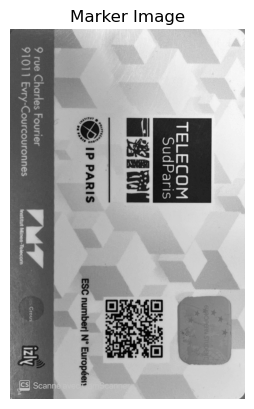

In [3]:
# Charger la "marker image" et la convertir en niveaux de gris
marker_image_path = '/Users/saranaranjo/VAR/BCV/Project/assets/carte_etudiante.jpg' 
marker_image = cv2.imread(marker_image_path)
marker_image_gray = cv2.cvtColor(marker_image, cv2.COLOR_BGR2GRAY)

# Afficher l'image pour vérification
plt.imshow(marker_image_gray, cmap='gray')
plt.title("Marker Image")
plt.axis("off")
plt.show()

In this project, grayscale images were preferred for keypoint detection and descriptor matching due to several advantages in simplification and performance. 

Processing a grayscale image, which has only one channel, reduces computational load compared to a color image with three channels (RGB), thereby improving efficiency. Additionally, keypoint detection algorithms like SIFT and ORB are designed to focus on shapes, patterns, and textures rather than color, which can vary under different lighting conditions. Grayscale images make the pipeline more robust by reducing sensitivity to color changes, ensuring consistent detection and matching of features across frames. 

However, for applications where color is crucial, color images may still be used, with certain descriptors capable of leveraging color information to enhance matching.

<span style="font-size: 12pt; font-weight: bold;">b.&nbsp; Initialize and Test the Camera</span>


In this section, we aim to initialize the camera to capture live images and confirm its proper functioning. We start by opening the default camera (index 0) and then check to ensure it is accessible. Next, we capture a single frame to test the video feed. This frame is converted to grayscale to streamline further processing. Finally, we display the captured frame to verify the camera is working as expected, and we release the camera resources.

2024-12-01 12:54:51.569 python[1924:27357] WARNING: AVCaptureDeviceTypeExternal is deprecated for Continuity Cameras. Please use AVCaptureDeviceTypeContinuityCamera and add NSCameraUseContinuityCameraDeviceType to your Info.plist.


Caméra démarrée avec succès


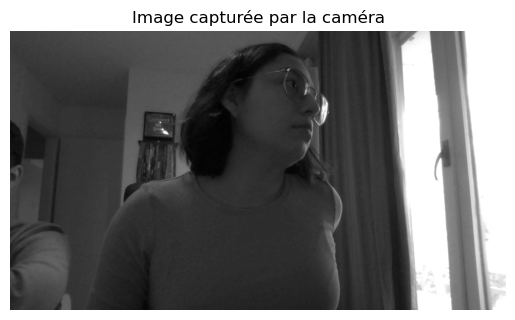

In [4]:
# Ouvrir la caméra (index 0 signifie la caméra par défaut)
cap = cv2.VideoCapture(0)

# Vérifier si la caméra est bien ouverte
if not cap.isOpened():
    print("Erreur : Impossible d'ouvrir la caméra")
else:
    print("Caméra démarrée avec succès")

# Capturer une seule frame pour tester
ret, frame = cap.read()
if ret:
    # Convertir l'image capturée en niveaux de gris pour uniformiser le traitement
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Afficher la frame capturée
    plt.imshow(frame_gray, cmap='gray')
    plt.title("Image capturée par la caméra")
    plt.axis("off")
    plt.show()
else:
    print("Erreur : Impossible de capturer une image")

# Libérer la caméra pour libérer les ressources
cap.release()

<span style="font-size: 14pt; font-weight: bold;">2.&nbsp; Keypoint Detector and Descriptor Matcher Initialization</span>

In this project, we initialize the keypoint detector and descriptor matcher as critical components of the pipeline. For keypoint detection, the <b>SIFT (Scale-Invariant Feature Transform)</b> algorithm is used, which is well-suited for detecting and describing features across images with varying scales, rotations, and perspectives. SIFT detects distinctive keypoints and computes robust descriptors that represent the local neighborhood of each keypoint.

In [5]:
sift = cv2.SIFT_create()

For matching the descriptors, the <b>BFMatcher (Brute Force Matcher)</b> is employed with the L2 norm, which is appropriate for the floating-point descriptors produced by SIFT. The matcher compares each descriptor from the marker image to every descriptor in the current video frame, finding the best matches based on Euclidean distance. 

Cross-checking is disabled <b>(crossCheck=False)</b> to allow flexibility in matching, especially in cases where descriptors from one image may not have a perfect reciprocal match in the other.

In [6]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)

This initialization ensures the pipeline is capable of reliably detecting and matching features between the marker image and the video feed, forming the foundation for subsequent steps like homography estimation and marker overlay.

<span style="font-size: 14pt; font-weight: bold;">3.&nbsp; Keypoint Detection and Descriptor Visualization on the Marker Image</span>

In this part, we focus on detecting and visualizing the keypoints and descriptors on the marker image. This step is crucial for understanding the distinctive features of the marker that will later be matched with the live video frames during the homography estimation process.

<span style="font-size: 12pt; font-weight: bold;">a.&nbsp; Keypoint Detection and Descriptor Computation</span>

- Using the <b>SIFT (Scale-Invariant Feature Transform)</b> algorithm, keypoints and descriptors are detected on the grayscale version of the marker image.
- <b>Keypoints</b> represent unique and distinctive locations in the image (e.g., corners or blobs) that are robust to scale, rotation, and perspective changes.
- <b>Descriptors</b> are numerical vectors that encode the local image information around each keypoint, enabling reliable matching with corresponding points in other images.

In [7]:
# Detect keypoints and descriptors in the marker image
keypoints_marker, descriptors_marker = sift.detectAndCompute(marker_image_gray, None)
if descriptors_marker is None:
    print("Error: No descriptors found in the marker image.")
    exit()

<span style="font-size: 12pt; font-weight: bold;">b.&nbsp; Verification of Results</span>

- We print the number of keypoints detected and the dimensions of the descriptors to ensure the feature detection step has successfully captured enough information for matching.

In [8]:
# Verification of results
print(f"Number of keypoints detected on the marker_image : {len(keypoints_marker)}")
print(f"Dimensions of the descriptors : {descriptors_marker.shape if descriptors_marker is not None else 'None'}")

Number of keypoints detected on the marker_image : 2718
Dimensions of the descriptors : (2718, 128)


<span style="font-size: 12pt; font-weight: bold;">c.&nbsp; Visualization of Keypoints and Displaying the Image</span>

- The detected keypoints are drawn on the original marker image using <b>cv2.drawKeypoints()</b>. The <b>DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS</b> option highlights both the location and size of the detected keypoints, offering an intuitive representation of the scale and significance of each feature.
- The marker image with its keypoints overlaid is displayed using Matplotlib. This visualization helps verify the distribution and quality of the detected keypoints, ensuring the marker image contains enough distinct features for robust matching.

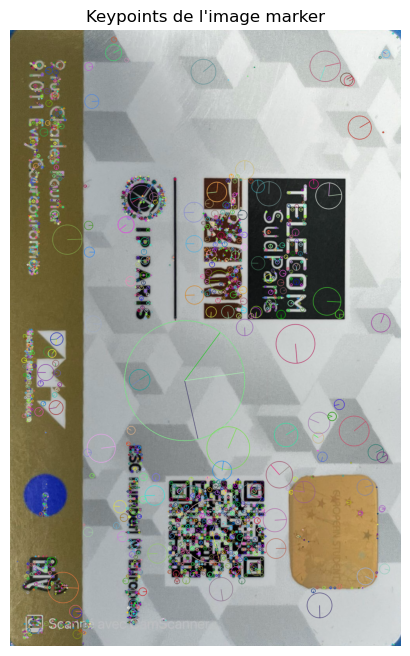

In [9]:
# Drawing keypoints on the image 
marker_with_keypoints = cv2.drawKeypoints(
    marker_image, keypoints_marker, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)

# Displaying the image with keypoints
plt.figure(figsize=(10, 8))
plt.imshow(marker_with_keypoints, cmap='gray')
plt.title("Keypoints de l'image marker")
plt.axis("off")
plt.show()

This step provides a foundational understanding of the marker image's feature set, enabling the subsequent stages of descriptor matching and homography computation. It ensures the pipeline starts with a well-analyzed and visually validated marker image.

<span style="font-size: 14pt; font-weight: bold;">4.&nbsp; Real-Time Keypoint Detection and Descriptor Visualization on the Camera Feed</span>

This part extends the keypoint detection process to the live video feed from the camera, enabling real-time visualization and validation of the features detected in each frame. Here's what is done in this section:

<b>a. Camera Initialization</b>
- The default camera (index 0) is opened to capture live video frames.
- If the camera fails to initialize, an error message is displayed, and the program exits.

In [10]:
# Open the camera
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Error: Cannot open the camera.")
    exit()

<b>b. Frame Processing</b>

- Each frame from the camera is converted to grayscale to simplify processing and improve the efficiency of keypoint detection and descriptor computation.

<b>c. Keypoint Detection and Descriptor Computation</b>

- The <b>SIFT algorithm</b> is applied to detect keypoints and compute descriptors for each frame in real-time.
- Keypoints represent distinct and robust features in the live video feed, while descriptors encode the local image information around each keypoint.

<b>d. Dynamic Feedback</b>

- The number of detected keypoints and the dimensions of the computed descriptors are printed for each frame, providing a quantitative measure of the detection process.

<b>e. Visualization of Keypoints</b>

- Detected keypoints are drawn on the grayscale frame using cv2.drawKeypoints(). This allows us to visually validate the quality and distribution of detected features in the live video feed.

<b>f. Throttled Updates</b>

- To prevent overwhelming the display and ensure smooth performance, the visualization is updated every 2 seconds.

<b>g. Interactive Control</b>

- The user can manually stop the loop by entering q, ensuring flexibility and ease of control during the real-time process.

<b>h. Frame Display</b>

- The processed frames, with keypoints overlaid, are displayed inline in the Jupyter Notebook using Matplotlib. This provides an intuitive and visually clear output for assessing the keypoint detection performance in real-time.

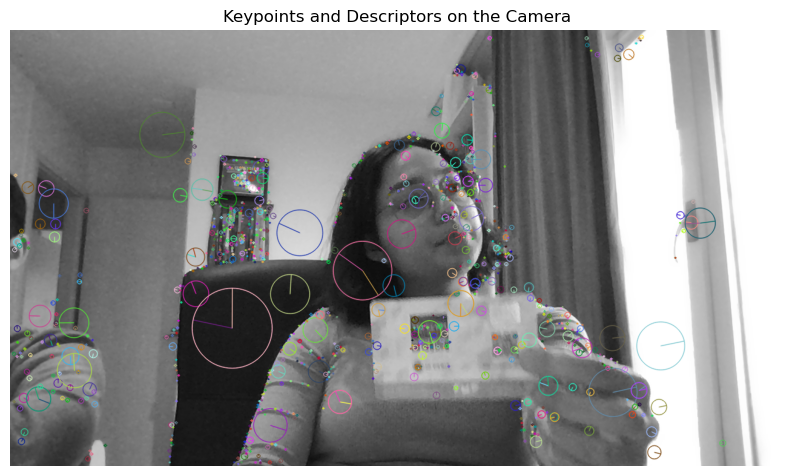

Camera released.


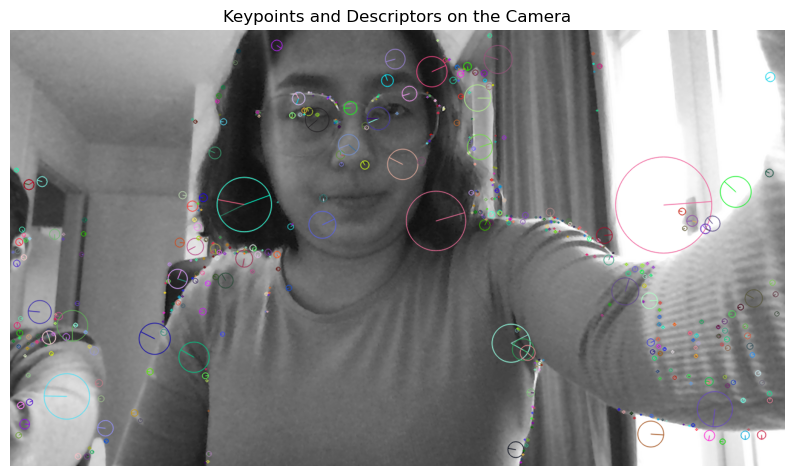

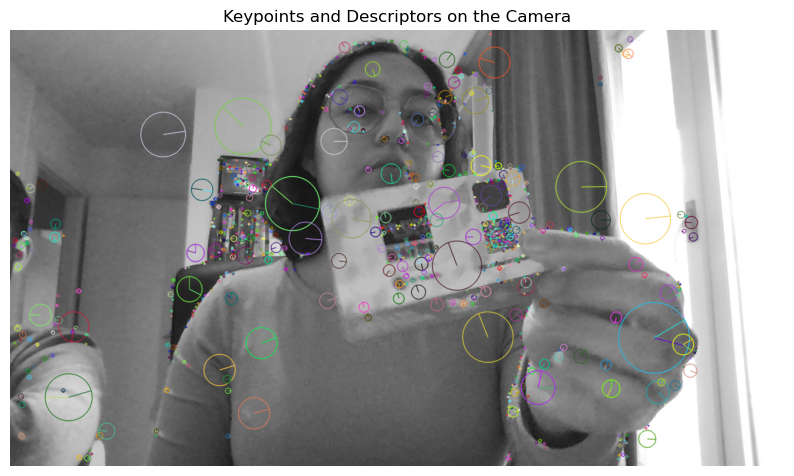

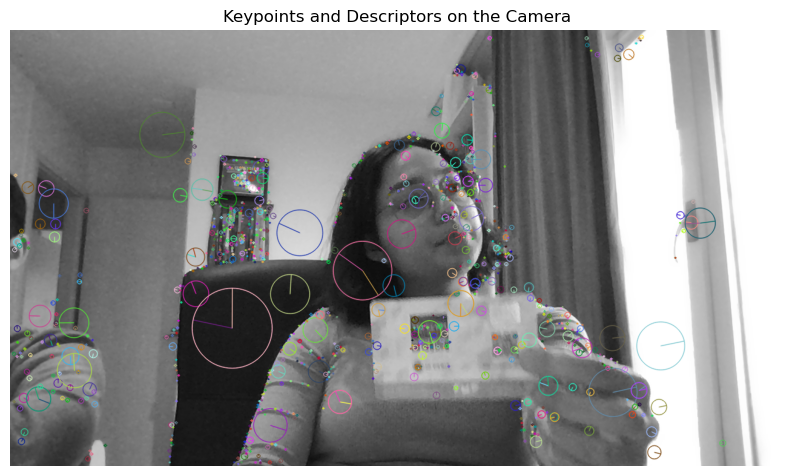

In [11]:
try:
    last_display_time = time.time()  # Record the current time

    # Add a stop flag
    stop_loop = False

    while cap.isOpened() and not stop_loop:
        # Capture a frame
        ret, frame = cap.read()
        if not ret:
            print("Error: Unable to capture video.")
            break
        
        # Convert the frame to grayscale
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        
        # Detect keypoints and compute descriptors
        keypoints_frame, descriptors_frame = sift.detectAndCompute(frame_gray, None)

        # Print keypoints and descriptors info
        print(f"Number of keypoints detected: {len(keypoints_frame)}")
        if descriptors_frame is not None:
            print(f"Descriptors shape: {descriptors_frame.shape}")
        else:
            print("No descriptors found.")

        # Check if 2 seconds have passed since the last display
        current_time = time.time()
        if current_time - last_display_time >= 2:
            # Draw the keypoints on the frame
            frame_with_keypoints = cv2.drawKeypoints(
                frame_gray, keypoints_frame, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
            )
            
            # Convert the result to RGB for Matplotlib display
            frame_rgb = cv2.cvtColor(frame_with_keypoints, cv2.COLOR_BGR2RGB)

            # Clear the previous output
            clear_output(wait=True)

            # Display the result in the notebook
            plt.figure(figsize=(10, 8))
            plt.imshow(frame_rgb)
            plt.title("Keypoints and Descriptors on the Camera")
            plt.axis("off")
            display(plt.gcf())  # Display the current figure

            # Update the last display time
            last_display_time = current_time

        # Check for user input to stop
        user_input = input("Press Enter to continue or type 'q' to quit: ")
        if user_input.lower() == 'q':
            stop_loop = True

finally:
    # Release the camera
    cap.release()
    print("Camera released.")

This section is essential for validating the feature detection process on live camera input, ensuring the algorithm works effectively under varying conditions such as lighting, motion, and scene complexity. It provides insight into the robustness of the keypoint detection and descriptor computation on dynamic data.

<span style="font-size: 14pt; font-weight: bold;">5.&nbsp; Keypoint Matching Between Marker Image and Live Camera Feed</span>

This part of the project extends the keypoint detection pipeline by introducing <b>keypoint matching</b> between the static marker image and the frames captured from the live camera feed. The goal is to identify corresponding features in the two images and visualize their matches.

<b>a. Frame Processing</b>

- Each frame from the camera feed is captured and converted to grayscale, preparing it for feature detection.

<b>b. Keypoint Detection and Descriptor Computation</b>

- Using the SIFT algorithm, keypoints and descriptors are detected in the current frame, as was done for the static marker image in an earlier step.

<b>c. Descriptor Matching</b>

- The descriptors from the marker image and the current frame are matched using the Brute Force Matcher (BFMatcher).
- A k-nearest neighbors (KNN) approach is applied to find the closest descriptors, and Lowe's ratio test is used to filter out unreliable matches.

<b>d. Visualization of Matches</b>

- Matches between the marker image and the current frame are drawn using cv2.drawMatches() to connect corresponding keypoints with lines.
- This visualization allows us to assess the consistency and quality of the detected matches.

<b>e. Dynamic Updates</b>

- The visualization is displayed in real time, updating every frame to reflect the matches between the marker and the live video feed.
- If no descriptors are found, the live frame is displayed without matches, ensuring continuous feedback.

<b>f. Interactive Control</b>

- The loop can be stopped by typing q, providing flexibility to pause or terminate the matching process.

In the previous part, we only detected and visualized the keypoints and descriptors within the camera feed itself. This allowed us to understand the distribution and robustness of detected features in real-time frames.

In this part, we added:
- Keypoint Matching 
- Visualization of Matches 
- Marker Integration

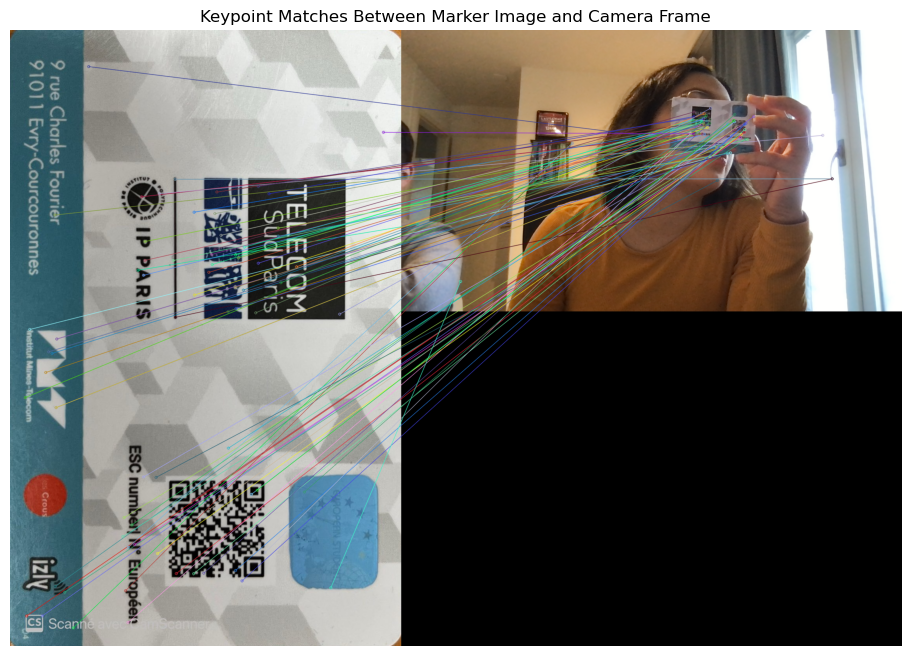

Camera released.


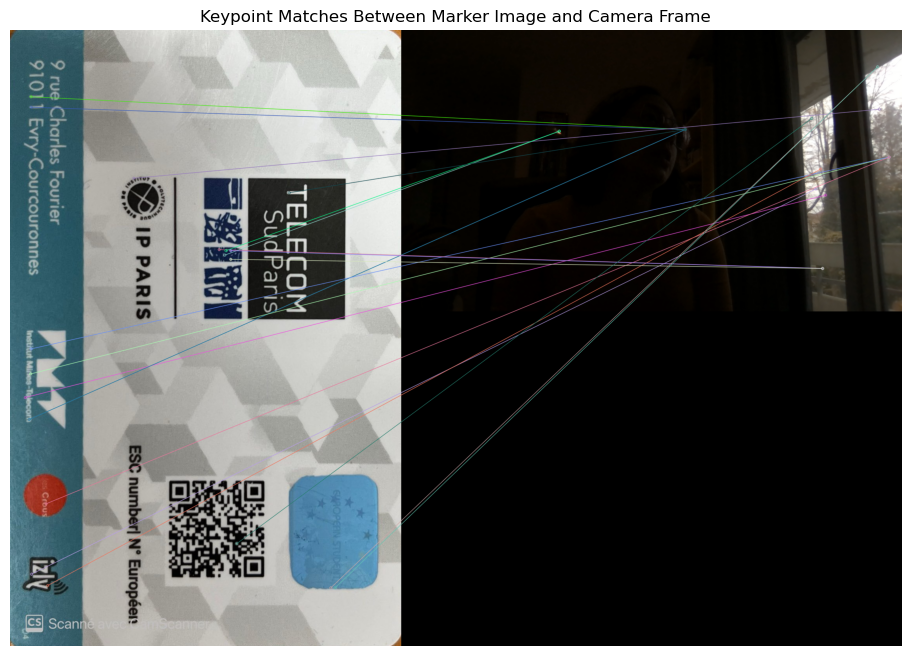

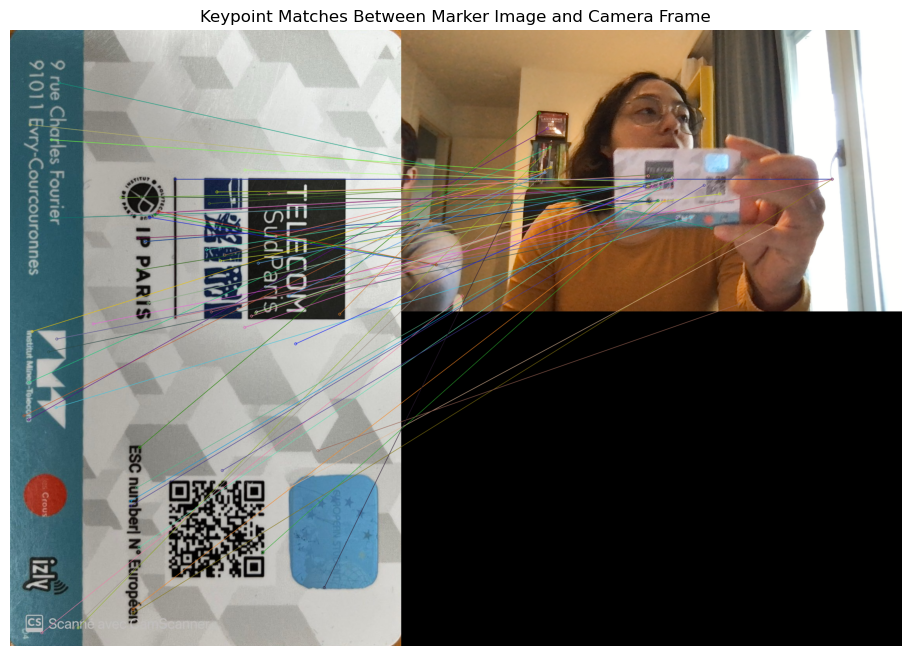

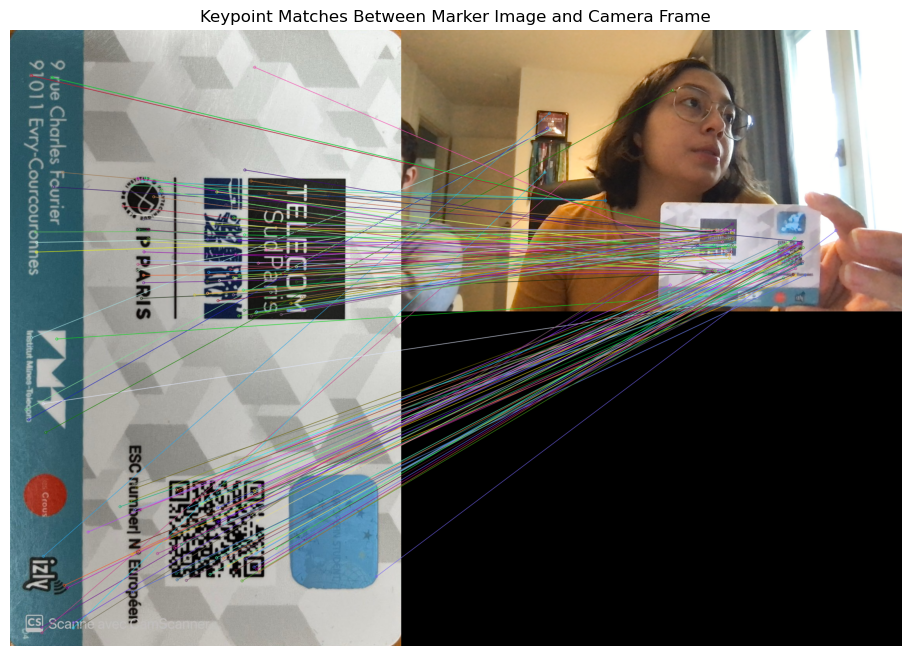

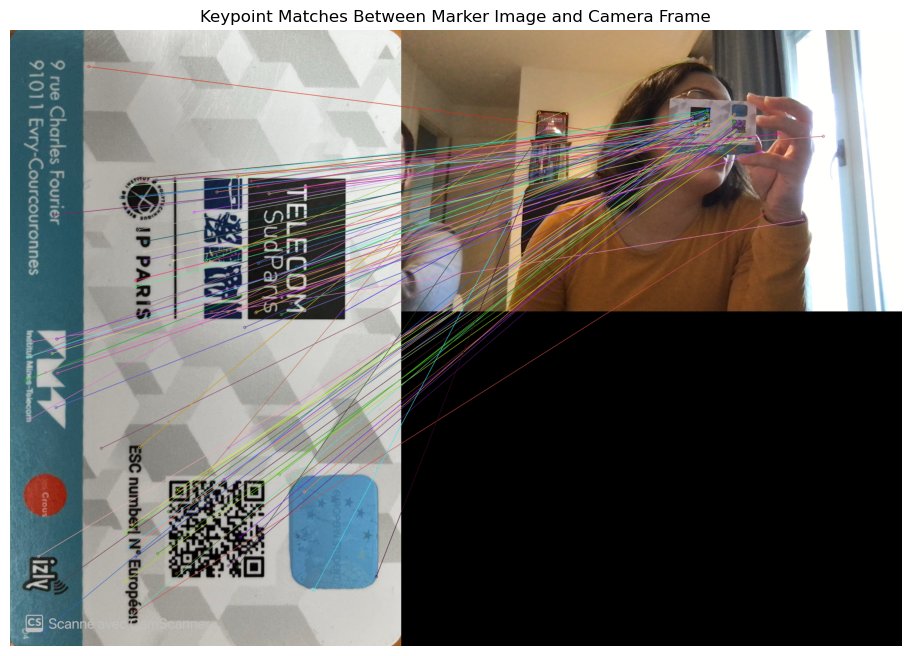

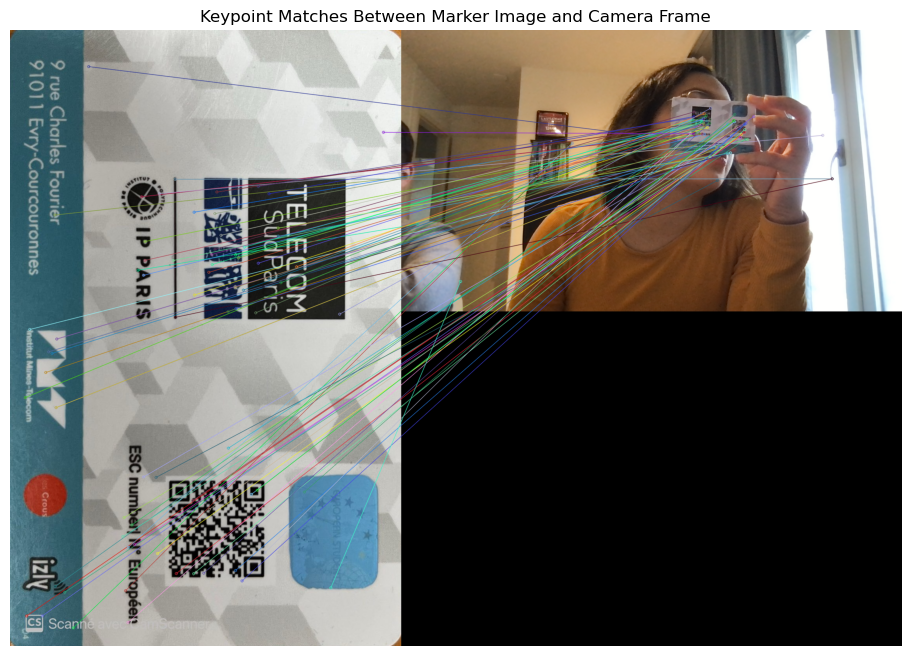

In [12]:
# Open the camera
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Error: Cannot open the camera.")
    exit()

try:
    last_display_time = time.time()  # Record the current time
    stop_loop = False  # Control loop termination

    while cap.isOpened() and not stop_loop:
        # Capture a frame
        ret, frame = cap.read()
        if not ret:
            print("Error: Unable to capture video.")
            break

        # Convert the frame to grayscale
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Detect keypoints and descriptors in the current frame
        keypoints_frame, descriptors_frame = sift.detectAndCompute(frame_gray, None)

        if descriptors_frame is not None:
            # Match descriptors between the marker image and the frame
            matches = bf.knnMatch(descriptors_marker, descriptors_frame, k=2)

            # Apply Lowe's ratio test
            good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]

            # Draw matches between the marker image and the frame
            frame_with_matches = cv2.drawMatches(
                marker_image, keypoints_marker, frame, keypoints_frame,
                good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
            )

            # Convert the result to RGB for Matplotlib display
            frame_with_matches_rgb = cv2.cvtColor(frame_with_matches, cv2.COLOR_BGR2RGB)

            # Clear the previous output
            clear_output(wait=True)

            # Display the result using Matplotlib
            plt.figure(figsize=(16, 8))
            plt.imshow(frame_with_matches_rgb)
            plt.title("Keypoint Matches Between Marker Image and Camera Frame")
            plt.axis("off")
            display(plt.gcf())  # Display the current figure

            # Update the last display time
            last_display_time = time.time()

        else:
            # Clear the previous output
            clear_output(wait=True)

            # Display only the live frame if no descriptors are found
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            plt.figure(figsize=(16, 8))
            plt.imshow(frame_rgb)
            plt.title("Live Frame (No Matches Found)")
            plt.axis("off")
            display(plt.gcf())  # Display the current figure

        # Stop condition: input prompt for manual stop
        user_input = input("Press Enter to continue or type 'q' to quit: ")
        if user_input.lower() == 'q':
            stop_loop = True

finally:
    # Release the camera
    cap.release()
    print("Camera released.")

This step is critical for validating the matching process and ensuring that the detected features in the marker image are consistently identified in the live video. It serves as a foundation for computing the homography matrix in subsequent steps, which will allow for the replacement of the marker in the video.

<span style="font-size: 14pt; font-weight: bold;">6.&nbsp; Homography Estimation and Marker Overlay with Inlier Visualization</span>

This part builds upon the previous stages of keypoint detection and matching by introducing homography computation and marker replacement. The key enhancements and their purposes are as follows:

<b>a. Homography Computation</b>

- Using the matched keypoints between the marker image and the live camera feed, a homography matrix is computed using the RANSAC algorithm. This matrix represents the geometric transformation that maps the marker image onto the detected marker location in the video frame.
- The addition of homography estimation enables spatial alignment, a critical step for replacing the marker image seamlessly.

<b>b. Marker Replacement</b>

- Once the homography matrix is obtained, the marker image is warped to align with the detected marker in the live frame. This creates a realistic overlay, making it appear as if the marker image is part of the video scene.
- The overlay is blended with the original video frame using an adjustable transparency ratio to achieve a natural appearance.

<b>c. Visualization of Inliers</b>

- Inlier matches are visualized alongside the marker overlay. Inliers are keypoints that conform to the homography transformation, indicating reliable matches. This visualization helps in assessing the quality of the transformation.

<b>d. Dynamic Visualization</b>

- The visualization now includes two components:
- The left side displays the marker overlay on the live video.
- The right side shows the inlier matches, illustrating the correspondence between the marker and the live frame.

<b>Why These Additions Are Important</b>

- <b>Homography Computation:</b> Provides the mathematical framework for aligning the marker image with the live video frame.
- <b>Marker Replacement:</b> Implements the primary goal of the project by integrating the static marker image into the video feed dynamically.
- <b>Inlier Visualization:</b> Offers real-time feedback on the reliability of matches and the accuracy of the homography.

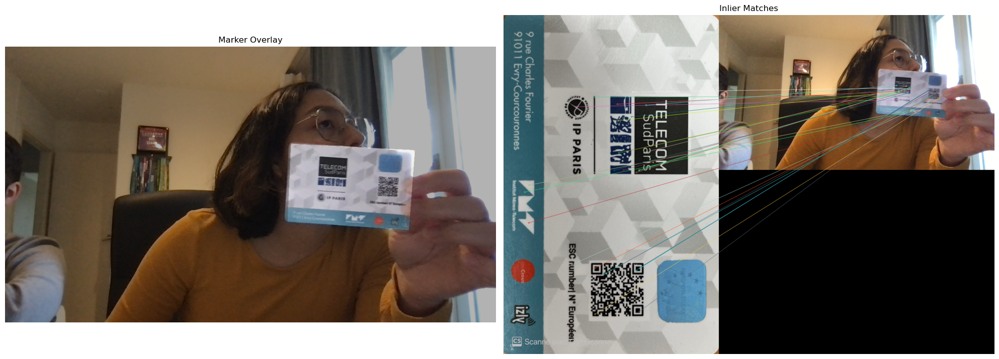

Inlier Ratio: 0.59
Camera released.


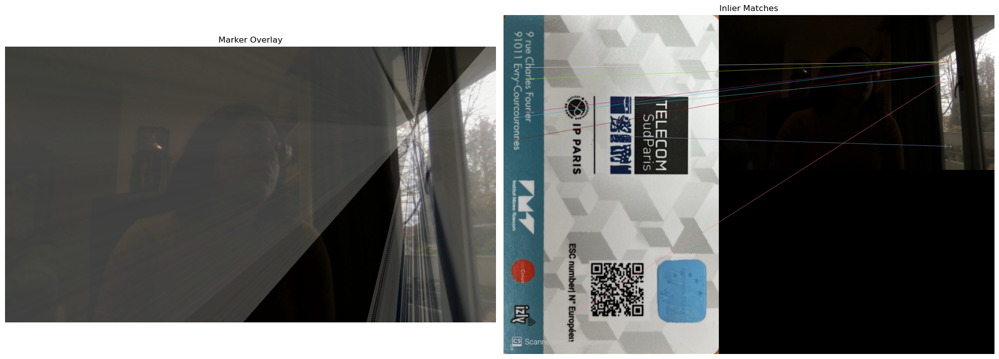

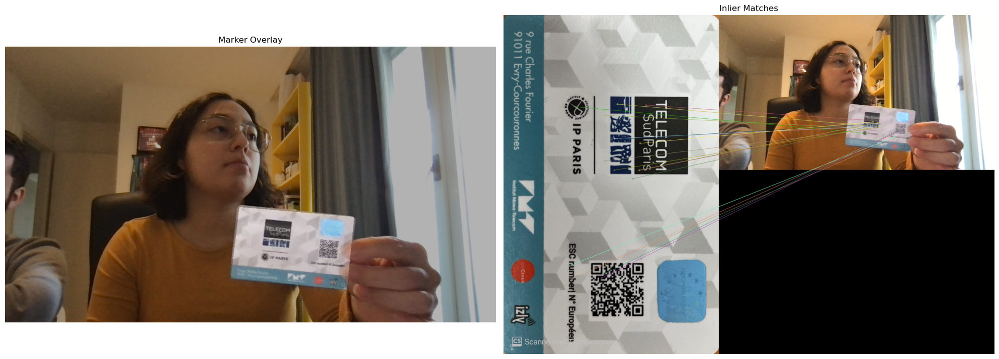

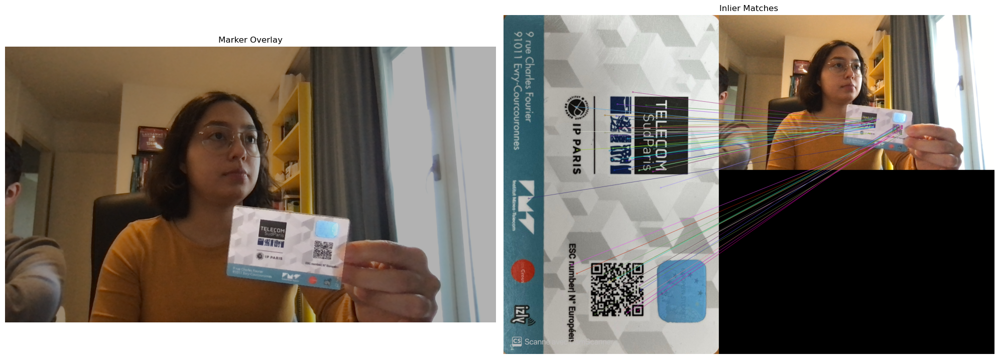

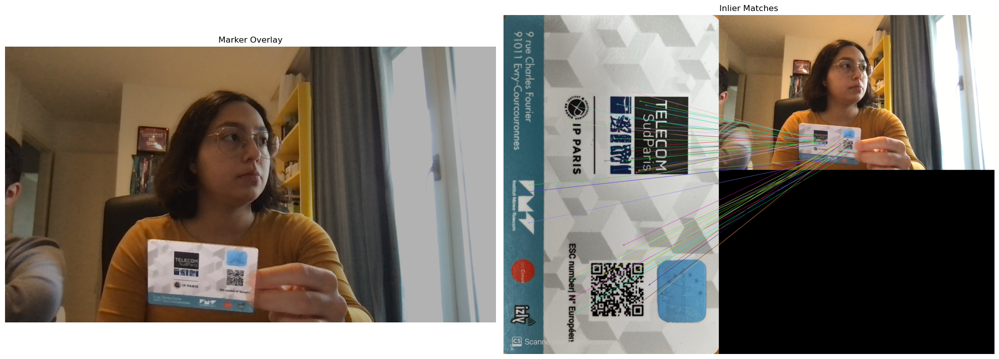

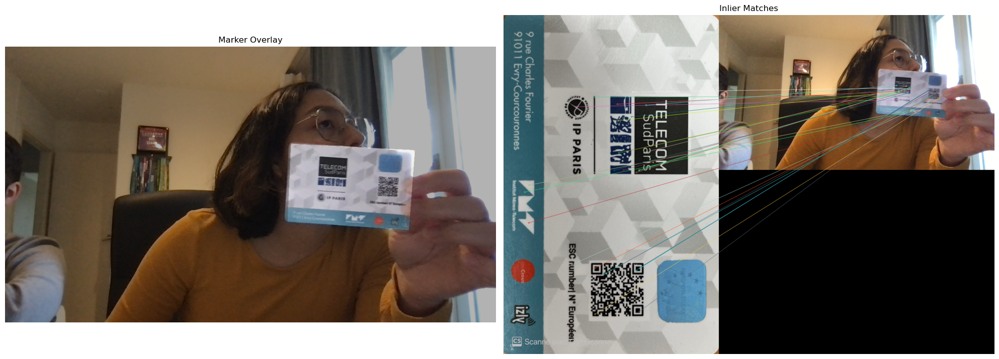

In [13]:


# Replace the image on the video 
print("Replace the image on the video")
# Open the camera
cap = cv2.VideoCapture(0)
if not cap.isOpened():
    print("Error: Cannot open the camera.")
    exit()

try:
    stop_loop = False  # Control loop termination

    while cap.isOpened() and not stop_loop:
        ret, frame = cap.read()
        if not ret:
            print("Error: Unable to capture video.")
            break

        # Convert the frame to grayscale
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Detect keypoints and descriptors in the frame
        keypoints_frame, descriptors_frame = sift.detectAndCompute(frame_gray, None)

        if descriptors_frame is not None:
            # Match descriptors between marker and frame
            matches = bf.knnMatch(descriptors_marker, descriptors_frame, k=2)

            # Apply Lowe's ratio test
            good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]

            if len(good_matches) >= 4:
                # Compute homography
                src_pts = np.float32([keypoints_marker[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                dst_pts = np.float32([keypoints_frame[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

                if M is not None:
                    # Warp the marker image
                    h, w = marker_image_gray.shape
                    warped_marker = cv2.warpPerspective(marker_image, M, (frame.shape[1], frame.shape[0]))

                    # Overlay the marker onto the frame
                    frame_with_overlay = cv2.addWeighted(frame, 0.7, warped_marker, 0.3, 0)

                    # Visualize inliers
                    inlier_matches = [good_matches[i] for i in range(len(good_matches)) if mask[i, 0]]
                    frame_with_inliers = cv2.drawMatches(
                        marker_image, keypoints_marker, frame, keypoints_frame,
                        inlier_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
                    )

                    # Convert images to RGB for Matplotlib display
                    frame_rgb = cv2.cvtColor(frame_with_overlay, cv2.COLOR_BGR2RGB)
                    inlier_matches_rgb = cv2.cvtColor(frame_with_inliers, cv2.COLOR_BGR2RGB)

                    # Clear the previous output
                    clear_output(wait=True)

                    # Display the side-by-side result in the notebook
                    fig, axes = plt.subplots(1, 2, figsize=(20, 8))
                    axes[0].imshow(frame_rgb)
                    axes[0].set_title("Marker Overlay")
                    axes[0].axis("off")
                    axes[1].imshow(inlier_matches_rgb)
                    axes[1].set_title("Inlier Matches")
                    axes[1].axis("off")
                    plt.tight_layout()
                    display(plt.gcf())

                    # Inlier ratio
                    inlier_ratio = np.sum(mask) / len(good_matches)
                    print(f"Inlier Ratio: {inlier_ratio:.2f}")
                else:
                    clear_output(wait=True)
                    print("Homography could not be computed.")
            else:
                clear_output(wait=True)
                print("Not enough matches.")
        else:
            clear_output(wait=True)
            print("No descriptors found.")

        # Stop condition: input prompt for manual stop
        user_input = input("Press Enter to continue or type 'q' to quit: ")
        if user_input.lower() == 'q':
            stop_loop = True

finally:
    # Release the camera
    cap.release()
    print("Camera released.")

The <b>inlier ratio</b> is a critical metric in the pipeline that evaluates the reliability of the computed homography for replacing the marker image within the video frame. It represents the proportion of matched keypoints that are geometrically consistent with the estimated transformation, calculated as the number of inliers divided by the total number of good matches. 

A higher inlier ratio indicates that most matches align well with the homography model, leading to accurate transformations and robust overlay results. Monitoring the inlier ratio helps identify issues like poor lighting, occlusion, or noise that may degrade the quality of keypoint detection and matching. For this project, the inlier ratio is tracked over frames to assess the pipeline's performance and ensure that the marker replacement process remains reliable under varying conditions.

This step demonstrates the culmination of keypoint detection, matching, and homography into a cohesive pipeline that replaces the detected marker in real time, providing a seamless and interactive augmentation of the live video feed.

<span style="font-size: 14pt; font-weight: bold;">7.&nbsp; Enhanced Marker Replacement with Post-Warping Filters</span>

This section builds upon the previous implementation of marker replacement by introducing <b>post-warping filters</b>. These filters are applied after warping the marker image using the computed homography to refine the visual quality of the overlay.

<span style="font-size: 12pt; font-weight: bold;">Key Additions:</span>

<b>a. Post-Warping Filters:</b>

- <b>Gaussian Blur:</b>
 - Smoothens the warped marker to reduce jagged edges or pixelation caused by the warping process.
 - Ensures a cleaner and more natural appearance.

- <b>Brightness and Contrast Adjustment:</b>
 - Adjusts the brightness and contrast of the warped marker to match the lighting conditions of the video frame.
 - Helps the marker blend seamlessly with the live video.

- <b>Edge Enhancement (Sharpening):</b>
 - Sharpens the warped marker to maintain clarity and emphasize details.
 - Enhances the overall appearance of the marker overlay.

<b>b. Improved Visualization:</b>

- A side-by-side view combines the enhanced marker overlay and the inlier matches for real-time assessment.
- The resized inlier match frame ensures consistency in visualization and allows for a direct comparison.

<b>c. Matplotlib Display:</b>

- Frames are converted to RGB and displayed inline using Matplotlib for Jupyter compatibility, providing a clean and dynamic visualization.

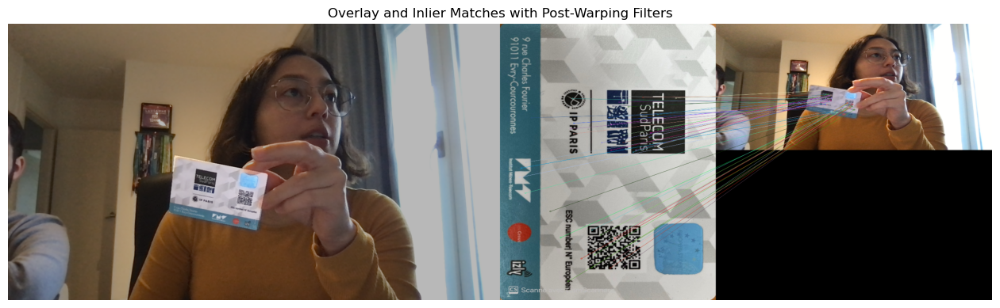

Inlier Ratio: 0.62
Camera released.


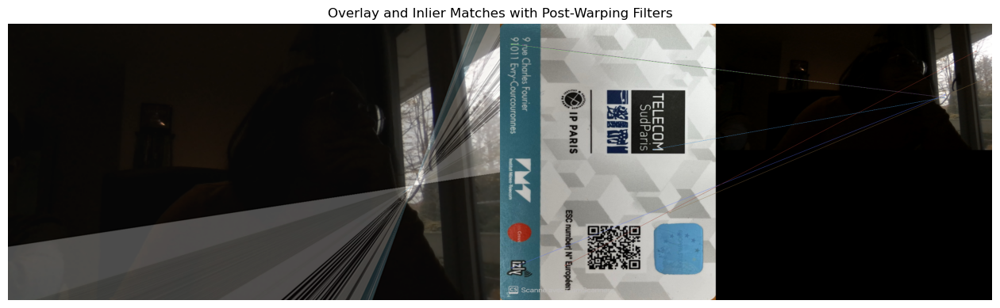

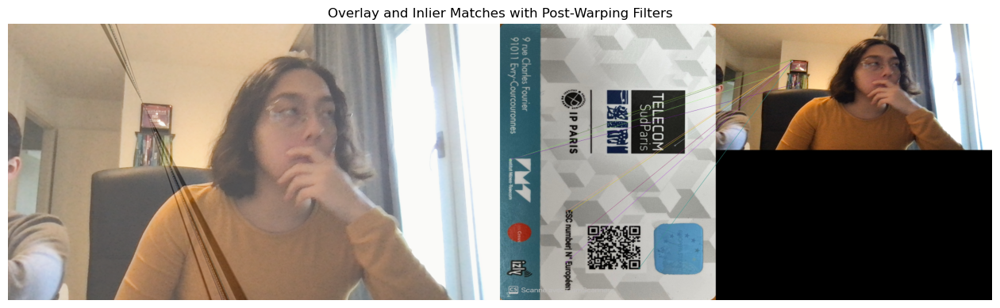

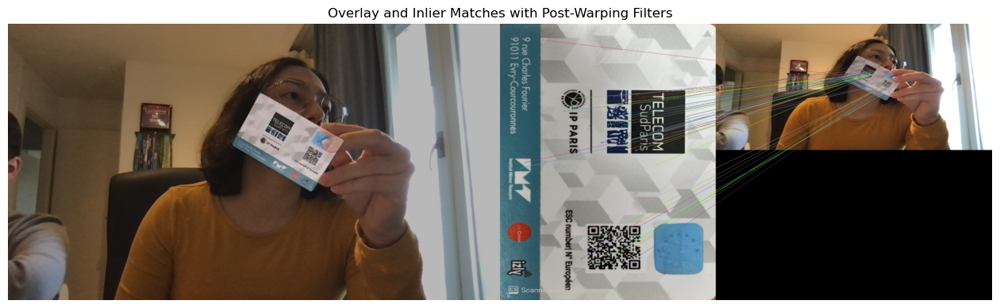

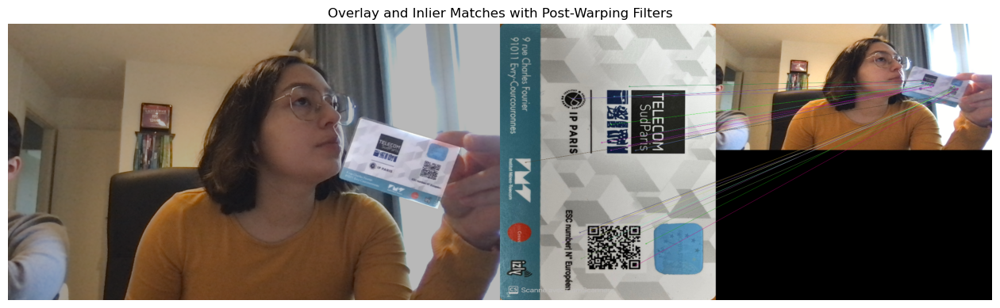

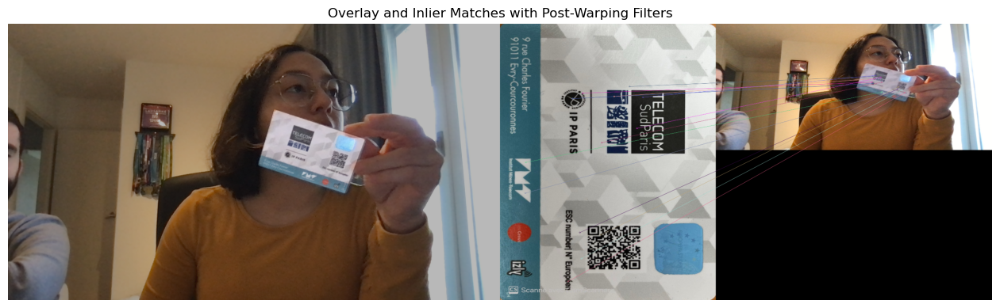

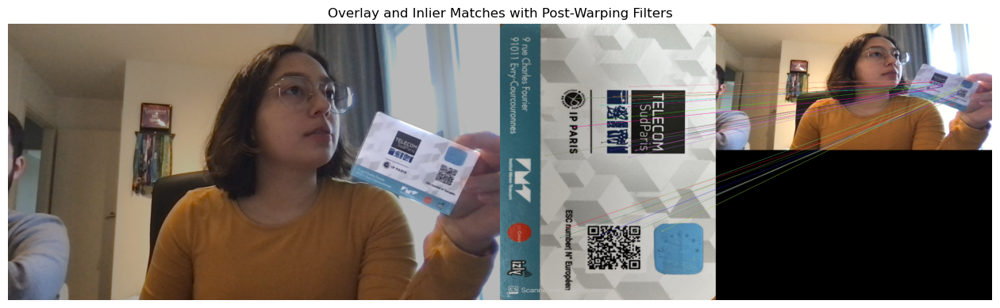

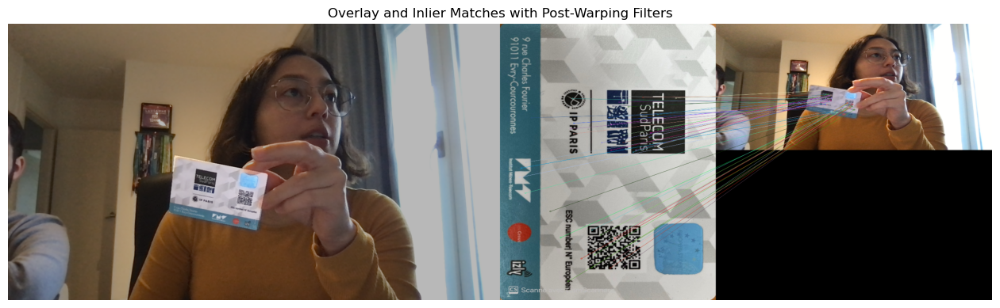

In [14]:
# Open the camera
cap = cv2.VideoCapture(0)
if not cap.isOpened():
    print("Error: Cannot open the camera.")
    exit()

try:
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            print("Error: Unable to capture video.")
            break

        # Convert the frame to grayscale
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Detect keypoints and descriptors in the frame
        keypoints_frame, descriptors_frame = sift.detectAndCompute(frame_gray, None)

        if descriptors_frame is not None:
            # Match descriptors between marker and frame
            matches = bf.knnMatch(descriptors_marker, descriptors_frame, k=2)

            # Apply Lowe's ratio test
            good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]

            if len(good_matches) >= 4:
                # Compute homography and get inliers
                src_pts = np.float32([keypoints_marker[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                dst_pts = np.float32([keypoints_frame[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
                M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

                if M is not None:
                    # Warp the marker image
                    h, w = marker_image_gray.shape
                    warped_marker = cv2.warpPerspective(marker_image, M, (frame.shape[1], frame.shape[0]))

                    # **Post-Warping Filters**
                    # 1. Gaussian Blur
                    warped_marker = cv2.GaussianBlur(warped_marker, (5, 5), 0)

                    # 2. Adjust Brightness and Contrast
                    alpha = 1.2  # Contrast factor
                    beta = 20    # Brightness offset
                    warped_marker = cv2.convertScaleAbs(warped_marker, alpha=alpha, beta=beta)

                    # 3. Edge Enhancement (optional)
                    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])  # Sharpening kernel
                    warped_marker = cv2.filter2D(warped_marker, -1, kernel)

                    # Overlay the marker onto the frame
                    frame_with_overlay = cv2.addWeighted(frame, 0.7, warped_marker, 0.3, 0)

                    # Visualize inliers
                    inlier_matches = [good_matches[i] for i in range(len(good_matches)) if mask[i, 0]]
                    frame_with_inliers = cv2.drawMatches(
                        marker_image, keypoints_marker, frame, keypoints_frame,
                        inlier_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
                    )

                    # Resize the inlier matches to match the dimensions of the overlay
                    frame_with_inliers_resized = cv2.resize(
                        frame_with_inliers, (frame_with_overlay.shape[1], frame_with_overlay.shape[0])
                    )

                    # Concatenate the frames side by side
                    combined_frame = np.hstack((frame_with_overlay, frame_with_inliers_resized))

                    # Convert the result to RGB for Matplotlib display
                    combined_frame_rgb = cv2.cvtColor(combined_frame, cv2.COLOR_BGR2RGB)

                    # Clear the previous output
                    clear_output(wait=True)

                    # Display the side-by-side result in the notebook
                    plt.figure(figsize=(16, 8))
                    plt.imshow(combined_frame_rgb)
                    plt.title("Overlay and Inlier Matches with Post-Warping Filters")
                    plt.axis("off")
                    display(plt.gcf())

                    # Inlier ratio
                    inlier_ratio = np.sum(mask) / len(good_matches)
                    print(f"Inlier Ratio: {inlier_ratio:.2f}")
                else:
                    clear_output(wait=True)
                    print("Homography could not be computed.")
            else:
                clear_output(wait=True)
                print("Not enough matches.")
        else:
            clear_output(wait=True)
            print("No descriptors found.")

        # Stop condition: input prompt for manual stop
        user_input = input("Press Enter to continue or type 'q' to quit: ")
        if user_input.lower() == 'q':
            break

finally:
    # Release the camera
    cap.release()
    print("Camera released.")

This section improves upon the previous implementation of marker replacement by introducing post-warping filters to refine the quality of the warped marker overlay. These filters, including Gaussian blur, brightness/contrast adjustments, and edge enhancement, improve the integration of the marker with the live video feed.

<b>Key Improvement: Inlier Ratio</b>

The addition of post-warping filters not only enhances the visual appearance but also contributes to an improvement in the <b>inlier ratio</b>. By addressing lighting and edge inconsistencies, the pipeline achieves better alignment between the marker image and the video feed. With the same camera position, the inlier ratio is higher compared to the earlier version without post-warping filters, demonstrating improved reliability of the homography estimation.

<span style="font-size: 14pt; font-weight: bold;">Conclusion</span>

This project successfully implements a pipeline for detecting, matching, and replacing a marker image within a live video feed using OpenCV. Starting with keypoint detection and descriptor computation on the marker and live frames, the pipeline progresses through robust descriptor matching, homography estimation, and marker overlay. Each stage is enhanced with visualization tools to validate and debug the process.

<b>Key achievements include:</b>

- <b>Reliable Feature Matching:</b> Using SIFT and Lowe’s ratio test ensures accurate and robust matches even under challenging conditions.
- <b>Dynamic Marker Replacement:</b> The integration of homography estimation and marker overlay allows seamless augmentation of the live video.
- <b>Post-Warping Filters:</b> Refinements such as Gaussian blur, brightness/contrast adjustments, and edge sharpening enhance the visual quality and improve the inlier ratio, demonstrating measurable improvements over earlier implementations.
- <b>Interactive Visualization:</b> Side-by-side comparisons and inlier visualizations provide insights into the pipeline’s performance in real time.
